In [1]:
import pickle
from tqdm import tqdm
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import sys
import os


from sklearn.model_selection import train_test_split
from sklearn.datasets import fetch_openml

from modules.sequential import *
from modules.linear import *
from modules.loss import *
from modules.activation import *


In [2]:
from sklearn.datasets import fetch_openml
mnist = fetch_openml('Fashion-MNIST', version=1, as_frame=False)
X, y = mnist.data, mnist.target.astype(int)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
y_train = np.eye(len(set(y_train)))[y_train]
y_test = np.eye(len(set(y_test)))[y_test]
classes_names_fashion_mnist = ['T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat', 'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']
X_train = X_train/255.0
X_test = X_test/255.0
display(X_train.shape, y_train.shape, X_test.shape, y_test.shape)

(56000, 784)

(56000, 10)

(14000, 784)

(14000, 10)

# using model 4

In [11]:
with open('models/model4.pkl', 'rb') as f:
    optim = pickle.load(f)
    
def get_embedding(X, optim, encoder_length=2):
    for i in range(2*encoder_length):
        X = optim.model_sequentiel._layers[i].forward(X)
    return X

X_train_embedding = get_embedding(X_train, optim, encoder_length=2)
display(X_train_embedding.shape)
	

(56000, 3)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 56000 samples in 0.049s...
[t-SNE] Computed neighbors for 56000 samples in 1.420s...
[t-SNE] Computed conditional probabilities for sample 1000 / 56000
[t-SNE] Computed conditional probabilities for sample 2000 / 56000
[t-SNE] Computed conditional probabilities for sample 3000 / 56000
[t-SNE] Computed conditional probabilities for sample 4000 / 56000
[t-SNE] Computed conditional probabilities for sample 5000 / 56000
[t-SNE] Computed conditional probabilities for sample 6000 / 56000
[t-SNE] Computed conditional probabilities for sample 7000 / 56000
[t-SNE] Computed conditional probabilities for sample 8000 / 56000
[t-SNE] Computed conditional probabilities for sample 9000 / 56000
[t-SNE] Computed conditional probabilities for sample 10000 / 56000
[t-SNE] Computed conditional probabilities for sample 11000 / 56000
[t-SNE] Computed conditional probabilities for sample 12000 / 56000
[t-SNE] Computed conditional probabilities for sam

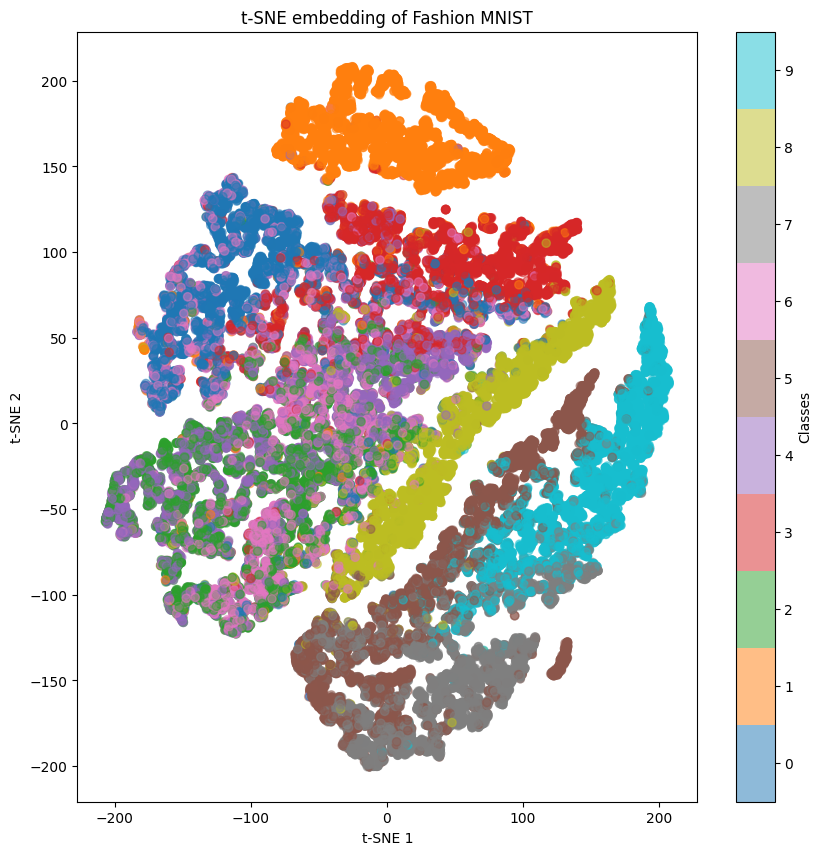

In [12]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, random_state=42, max_iter=3000, perplexity=30, verbose=2)
X_train_embedding_2d = tsne.fit_transform(X_train_embedding)

plt.figure(figsize=(10, 10))
plt.scatter(X_train_embedding_2d[:, 0], X_train_embedding_2d[:, 1], c=np.argmax(y_train, axis=1), cmap='tab10', alpha=0.5)
plt.colorbar(ticks=range(10), label='Classes')
plt.clim(-0.5, 9.5)
plt.title('t-SNE embedding of Fashion MNIST')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.show()

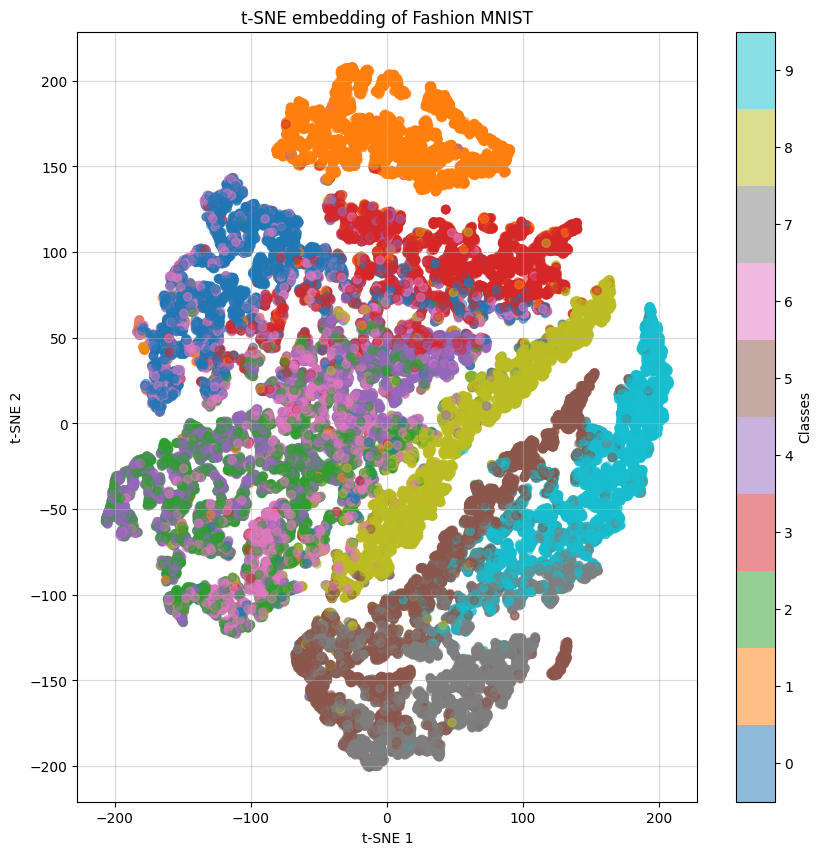

In [15]:

plt.figure(figsize=(10, 10))
plt.scatter(X_train_embedding_2d[:, 0], X_train_embedding_2d[:, 1], c=np.argmax(y_train, axis=1), cmap='tab10', alpha=0.5)
plt.colorbar(ticks=range(10), label='Classes')
#add grid to the plot
plt.grid(True, linestyle='-', alpha=0.5)
plt.clim(-0.5, 9.5)
plt.title('t-SNE embedding of Fashion MNIST')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.show()

In [13]:
tsne = TSNE(n_components=3, random_state=42, max_iter=3000, perplexity=30, verbose=2)
X_train_embedding = tsne.fit_transform(X_train_embedding)

with open("models/tsne_3d_projection_on_model4.pkl", "wb") as f:
    pickle.dump(X_train_embedding, f)
    
import plotly.express as px
import pandas as pd
import numpy as np

# Supposons :
# - X_3d.shape = (n_samples, 3)
# - labels.shape = (n_samples,) (ex: entiers de 0 à 9)
# - class_names : liste des noms correspondant aux labels (facultatif)

# Exemple : labels numériques
labels = np.argmax(y_train, axis=1)

# Ou noms de classes (optionnel mais plus lisible)
class_names = ['T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat',
               'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']
label_names = [class_names[i] for i in labels]

# Création du DataFrame pour Plotly
df = pd.DataFrame({
    'x': X_train_embedding[:, 0],
    'y': X_train_embedding[:, 1],
    'z': X_train_embedding[:, 2],
    'label': label_names  # ou 'label': labels pour version numérique
})

# Visualisation interactive
fig = px.scatter_3d(df, x='x', y='y', z='z',
                    color='label',
                    title='Projection 3D des embeddings',
                    opacity=0.7)

fig.update_traces(marker=dict(size=3))
fig.update_layout(legend_title_text='Classe')
fig.show()


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 56000 samples in 0.041s...
[t-SNE] Computed neighbors for 56000 samples in 2.795s...
[t-SNE] Computed conditional probabilities for sample 1000 / 56000
[t-SNE] Computed conditional probabilities for sample 2000 / 56000
[t-SNE] Computed conditional probabilities for sample 3000 / 56000
[t-SNE] Computed conditional probabilities for sample 4000 / 56000
[t-SNE] Computed conditional probabilities for sample 5000 / 56000
[t-SNE] Computed conditional probabilities for sample 6000 / 56000
[t-SNE] Computed conditional probabilities for sample 7000 / 56000
[t-SNE] Computed conditional probabilities for sample 8000 / 56000
[t-SNE] Computed conditional probabilities for sample 9000 / 56000
[t-SNE] Computed conditional probabilities for sample 10000 / 56000
[t-SNE] Computed conditional probabilities for sample 11000 / 56000
[t-SNE] Computed conditional probabilities for sample 12000 / 56000
[t-SNE] Computed conditional probabilities for sam

c:\Users\yacin\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [17]:
# save the model in html 
import plotly.io as pio
pio.write_html(fig, '3d_tsne_projection_on_model4.html', auto_open=True)

# using model 2

In [13]:
with open('models/model2.pkl', 'rb') as f:
    optim = pickle.load(f)
    
def get_embedding(X, optim, encoder_length=2):
    for i in range(2*encoder_length):
        X = optim.model_sequentiel._layers[i].forward(X)
    return X

X_train_embedding = get_embedding(X_train, optim, encoder_length=3)
display(X_train_embedding.shape)
	


(56000, 30)

In [7]:
import plotly.express as px
import pandas as pd
import numpy as np

# Supposons :
# - X_3d.shape = (n_samples, 3)
# - labels.shape = (n_samples,) (ex: entiers de 0 à 9)
# - class_names : liste des noms correspondant aux labels (facultatif)

# Exemple : labels numériques
labels = np.argmax(y_train, axis=1)

# Ou noms de classes (optionnel mais plus lisible)
class_names = ['T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat',
               'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']
label_names = [class_names[i] for i in labels]

# Création du DataFrame pour Plotly
df = pd.DataFrame({
    'x': X_train_embedding[:, 0],
    'y': X_train_embedding[:, 1],
    'z': X_train_embedding[:, 2],
    'label': label_names  # ou 'label': labels pour version numérique
})

# Visualisation interactive
fig = px.scatter_3d(df, x='x', y='y', z='z',
                    color='label',
                    title='Projection 3D des embeddings',
                    opacity=0.7)

fig.update_traces(marker=dict(size=3))
fig.update_layout(legend_title_text='Classe')
fig.show()


c:\Users\yacin\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  sf: grouped.get_group(s if len(s) > 1 else s[0])


In [9]:
# save in html file
fig.write_html("models/3d_plot_on_model4.html")

In [10]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, random_state=42, max_iter=3000, perplexity=30, verbose=2)
X_train_embedding_2d = tsne.fit_transform(X_train_embedding)

plt.figure(figsize=(10, 10))
plt.scatter(X_train_embedding_2d[:, 0], X_train_embedding_2d[:, 1], c=np.argmax(y_train, axis=1), cmap='tab10', alpha=0.5)
plt.colorbar(ticks=range(10), label='Classes')
plt.clim(-0.5, 9.5)
plt.title('t-SNE embedding of Fashion MNIST')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 56000 samples in 0.067s...
[t-SNE] Computed neighbors for 56000 samples in 2.378s...
[t-SNE] Computed conditional probabilities for sample 1000 / 56000
[t-SNE] Computed conditional probabilities for sample 2000 / 56000
[t-SNE] Computed conditional probabilities for sample 3000 / 56000
[t-SNE] Computed conditional probabilities for sample 4000 / 56000
[t-SNE] Computed conditional probabilities for sample 5000 / 56000
[t-SNE] Computed conditional probabilities for sample 6000 / 56000
[t-SNE] Computed conditional probabilities for sample 7000 / 56000
[t-SNE] Computed conditional probabilities for sample 8000 / 56000
[t-SNE] Computed conditional probabilities for sample 9000 / 56000
[t-SNE] Computed conditional probabilities for sample 10000 / 56000
[t-SNE] Computed conditional probabilities for sample 11000 / 56000
[t-SNE] Computed conditional probabilities for sample 12000 / 56000
[t-SNE] Computed conditional probabilities for sam

KeyboardInterrupt: 

In [ ]:
with open("models/tsne_projection.pkl", "wb") as f:
    pickle.dump(X_train_embedding_2d, f)


In [36]:
with open("models/tsne_projection.pkl", "rb") as f:
    X_train_embedding_2d = pickle.load(f)


In [43]:
tsne = TSNE(n_components=3, random_state=42, max_iter=3000, perplexity=30, verbose=2)
X_train_embedding_2d = tsne.fit_transform(X_train_embedding)

with open("models/tsne_3d_projection.pkl", "wb") as f:
    pickle.dump(X_train_embedding_2d, f)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 56000 samples in 0.002s...
[t-SNE] Computed neighbors for 56000 samples in 4.497s...
[t-SNE] Computed conditional probabilities for sample 1000 / 56000
[t-SNE] Computed conditional probabilities for sample 2000 / 56000
[t-SNE] Computed conditional probabilities for sample 3000 / 56000
[t-SNE] Computed conditional probabilities for sample 4000 / 56000
[t-SNE] Computed conditional probabilities for sample 5000 / 56000
[t-SNE] Computed conditional probabilities for sample 6000 / 56000
[t-SNE] Computed conditional probabilities for sample 7000 / 56000
[t-SNE] Computed conditional probabilities for sample 8000 / 56000
[t-SNE] Computed conditional probabilities for sample 9000 / 56000
[t-SNE] Computed conditional probabilities for sample 10000 / 56000
[t-SNE] Computed conditional probabilities for sample 11000 / 56000
[t-SNE] Computed conditional probabilities for sample 12000 / 56000
[t-SNE] Computed conditional probabilities for sam

In [45]:
import plotly.express as px
import pandas as pd
import numpy as np

# Supposons :
# - X_3d.shape = (n_samples, 3)
# - labels.shape = (n_samples,) (ex: entiers de 0 à 9)
# - class_names : liste des noms correspondant aux labels (facultatif)

# Exemple : labels numériques
labels = np.argmax(y_train, axis=1)

# Ou noms de classes (optionnel mais plus lisible)
class_names = ['T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat',
               'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']
label_names = [class_names[i] for i in labels]

# Création du DataFrame pour Plotly
df = pd.DataFrame({
    'x': X_train_embedding_2d[:, 0],
    'y': X_train_embedding_2d[:, 1],
    'z': X_train_embedding_2d[:, 2],
    'label': label_names  # ou 'label': labels pour version numérique
})

# Visualisation interactive
fig = px.scatter_3d(df, x='x', y='y', z='z',
                    color='label',
                    title='Projection 3D des embeddings',
                    opacity=0.7)

fig.update_traces(marker=dict(size=3))
fig.update_layout(legend_title_text='Classe')
fig.show()


c:\Users\yacin\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  sf: grouped.get_group(s if len(s) > 1 else s[0])


In [52]:
tsne = TSNE(n_components=3, random_state=42, max_iter=3000, perplexity=25, verbose=2, early_exaggeration=20)
X_train_embedding_2d = tsne.fit_transform(X_train_embedding)

with open("models/tsne_3d_projection_version2.pkl", "wb") as f:
    pickle.dump(X_train_embedding_2d, f)

[t-SNE] Computing 76 nearest neighbors...
[t-SNE] Indexed 56000 samples in 0.012s...
[t-SNE] Computed neighbors for 56000 samples in 7.132s...
[t-SNE] Computed conditional probabilities for sample 1000 / 56000
[t-SNE] Computed conditional probabilities for sample 2000 / 56000
[t-SNE] Computed conditional probabilities for sample 3000 / 56000
[t-SNE] Computed conditional probabilities for sample 4000 / 56000
[t-SNE] Computed conditional probabilities for sample 5000 / 56000
[t-SNE] Computed conditional probabilities for sample 6000 / 56000
[t-SNE] Computed conditional probabilities for sample 7000 / 56000
[t-SNE] Computed conditional probabilities for sample 8000 / 56000
[t-SNE] Computed conditional probabilities for sample 9000 / 56000
[t-SNE] Computed conditional probabilities for sample 10000 / 56000
[t-SNE] Computed conditional probabilities for sample 11000 / 56000
[t-SNE] Computed conditional probabilities for sample 12000 / 56000
[t-SNE] Computed conditional probabilities for sam

In [54]:
import plotly.express as px
import pandas as pd
import numpy as np

# Supposons :
# - X_3d.shape = (n_samples, 3)
# - labels.shape = (n_samples,) (ex: entiers de 0 à 9)
# - class_names : liste des noms correspondant aux labels (facultatif)

# Exemple : labels numériques
labels = np.argmax(y_train, axis=1)

# Ou noms de classes (optionnel mais plus lisible)
class_names = ['T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat',
               'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']
label_names = [class_names[i] for i in labels]

# Création du DataFrame pour Plotly
df = pd.DataFrame({
    'x': X_train_embedding_2d[:, 0],
    'y': X_train_embedding_2d[:, 1],
    'z': X_train_embedding_2d[:, 2],
    'label': label_names  # ou 'label': labels pour version numérique
})

# Visualisation interactive
fig = px.scatter_3d(df, x='x', y='y', z='z',
                    color='label',
                    title='Projection 3D des embeddings',
                    opacity=0.7)

fig.update_traces(marker=dict(size=3))
fig.update_layout(legend_title_text='Classe')
fig.show()


c:\Users\yacin\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [55]:
# save it into an html file
fig.write_html("models/tsne_3d_projection_version2.html")

In [50]:
tsne = TSNE(n_components=3, random_state=42, max_iter=3000, perplexity=45, verbose=2, early_exaggeration=20)
X_train_embedding_2d = tsne.fit_transform(X_train_embedding)

with open("models/tsne_2d_projection_version2.pkl", "wb") as f:
    pickle.dump(X_train_embedding_2d, f)

[t-SNE] Computing 136 nearest neighbors...
[t-SNE] Indexed 56000 samples in 0.004s...
[t-SNE] Computed neighbors for 56000 samples in 5.203s...
[t-SNE] Computed conditional probabilities for sample 1000 / 56000
[t-SNE] Computed conditional probabilities for sample 2000 / 56000
[t-SNE] Computed conditional probabilities for sample 3000 / 56000
[t-SNE] Computed conditional probabilities for sample 4000 / 56000
[t-SNE] Computed conditional probabilities for sample 5000 / 56000
[t-SNE] Computed conditional probabilities for sample 6000 / 56000
[t-SNE] Computed conditional probabilities for sample 7000 / 56000
[t-SNE] Computed conditional probabilities for sample 8000 / 56000
[t-SNE] Computed conditional probabilities for sample 9000 / 56000
[t-SNE] Computed conditional probabilities for sample 10000 / 56000
[t-SNE] Computed conditional probabilities for sample 11000 / 56000
[t-SNE] Computed conditional probabilities for sample 12000 / 56000
[t-SNE] Computed conditional probabilities for sa

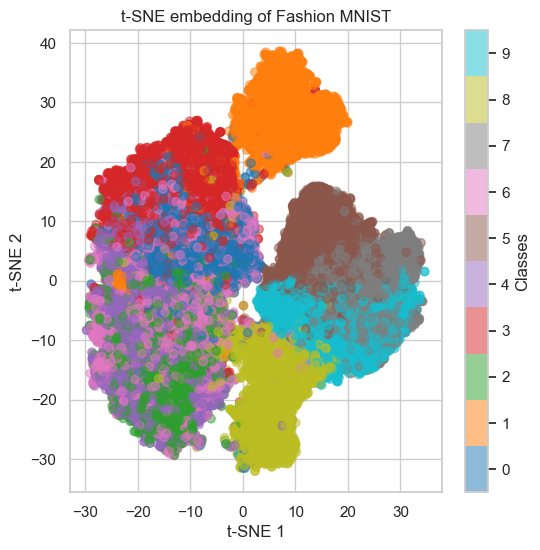

In [51]:
plt.figure(figsize=(6, 6))
plt.scatter(X_train_embedding_2d[:, 0], X_train_embedding_2d[:, 1], c=np.argmax(y_train, axis=1), cmap='tab10', alpha=0.5)
plt.colorbar(ticks=range(10), label='Classes')
plt.clim(-0.5, 9.5)
plt.title('t-SNE embedding of Fashion MNIST')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.show()